## variability over cp for a lot of alpha and beta

C:\Users\jerome\Anaconda3\lib\site-packages\ipykernel_launcher.py:61: RuntimeWarning: Mean of empty slice
C:\Users\jerome\Anaconda3\lib\site-packages\ipykernel_launcher.py:63: RuntimeWarning: Mean of empty slice


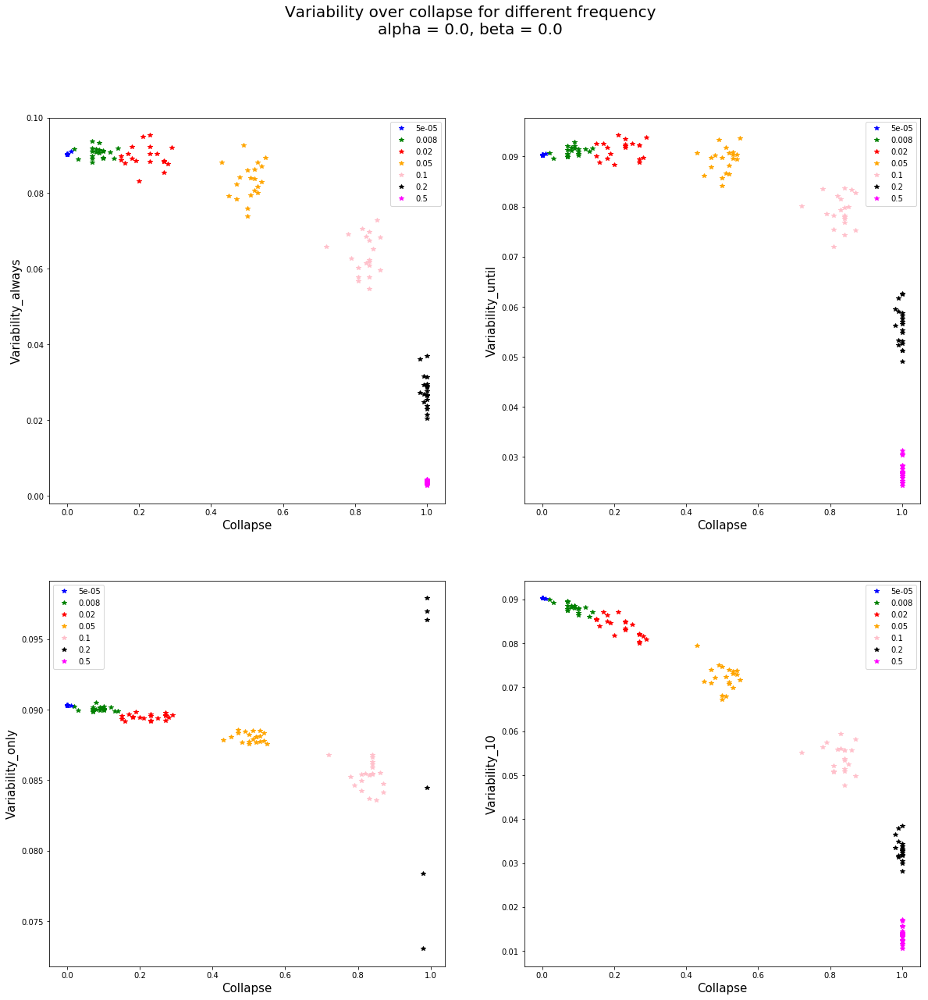

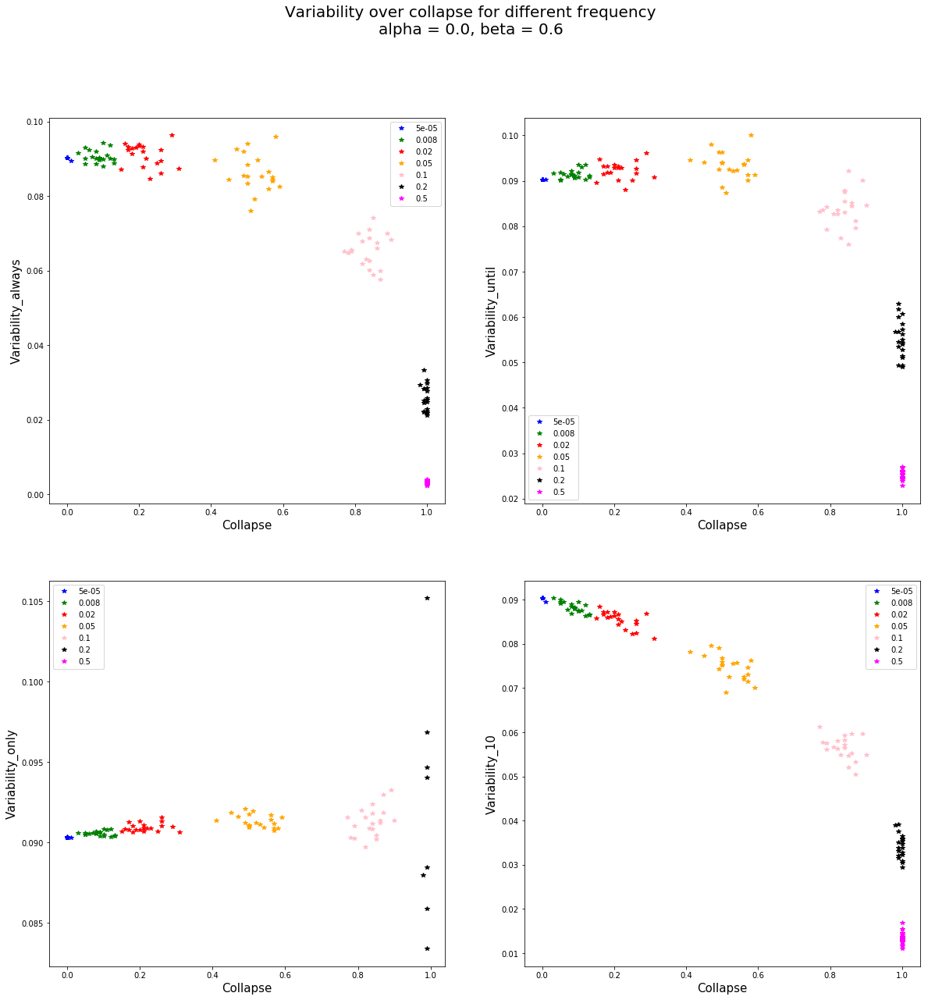

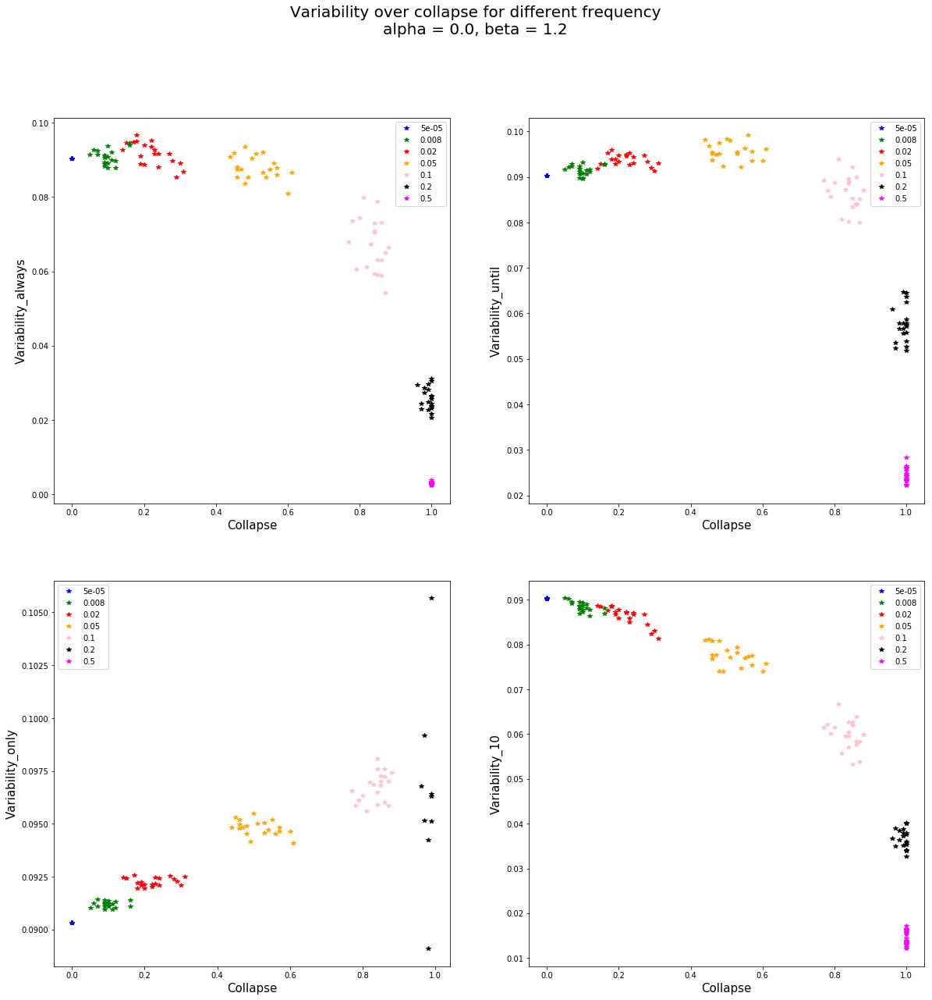

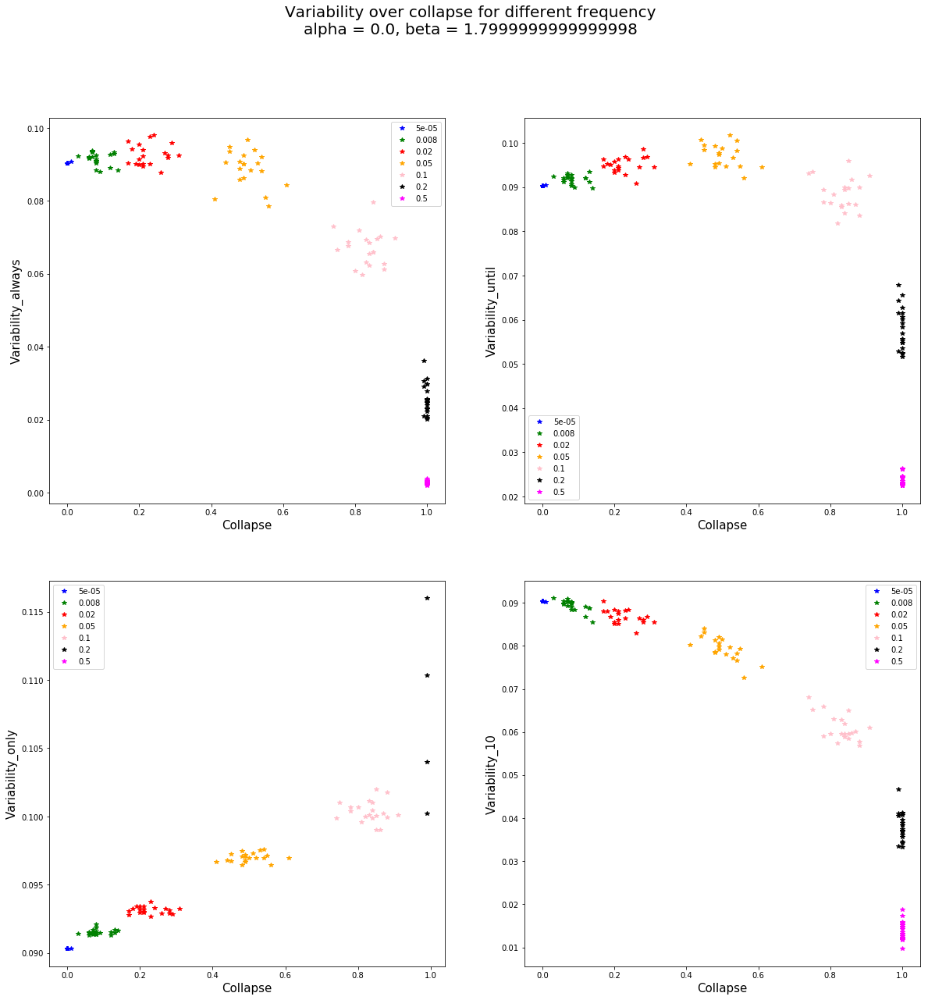

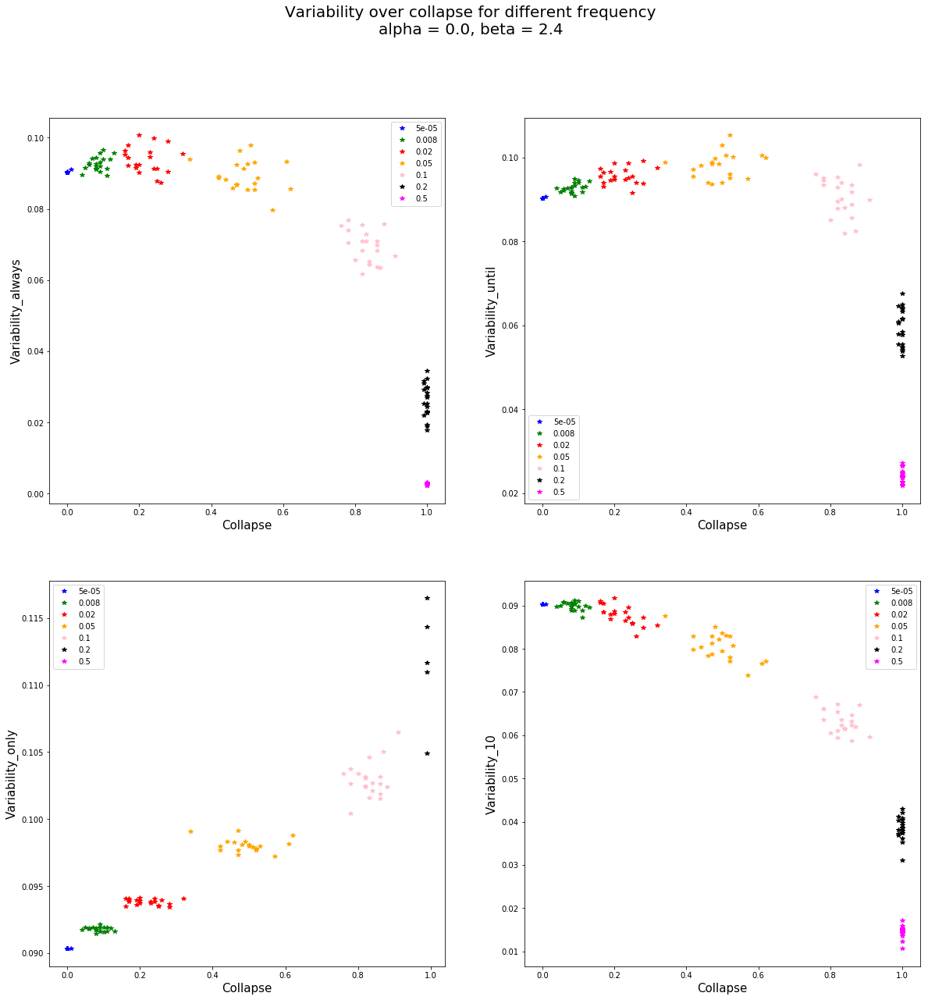

...

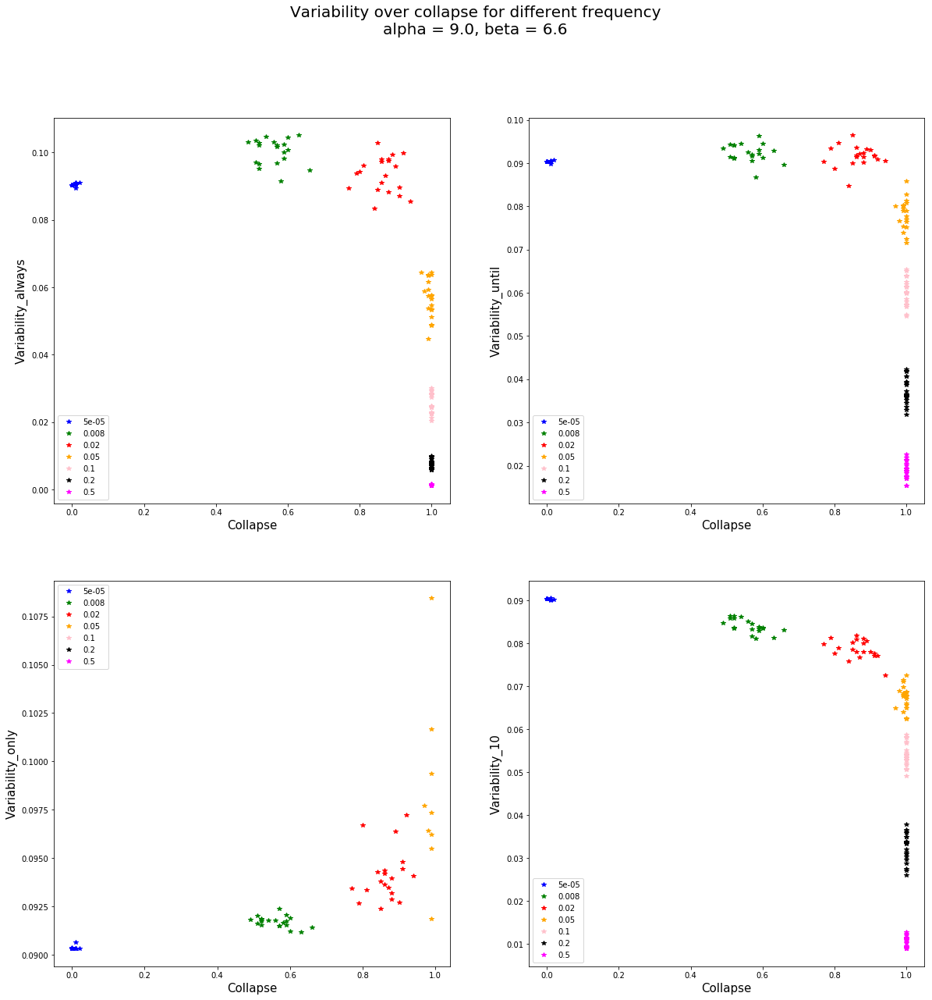

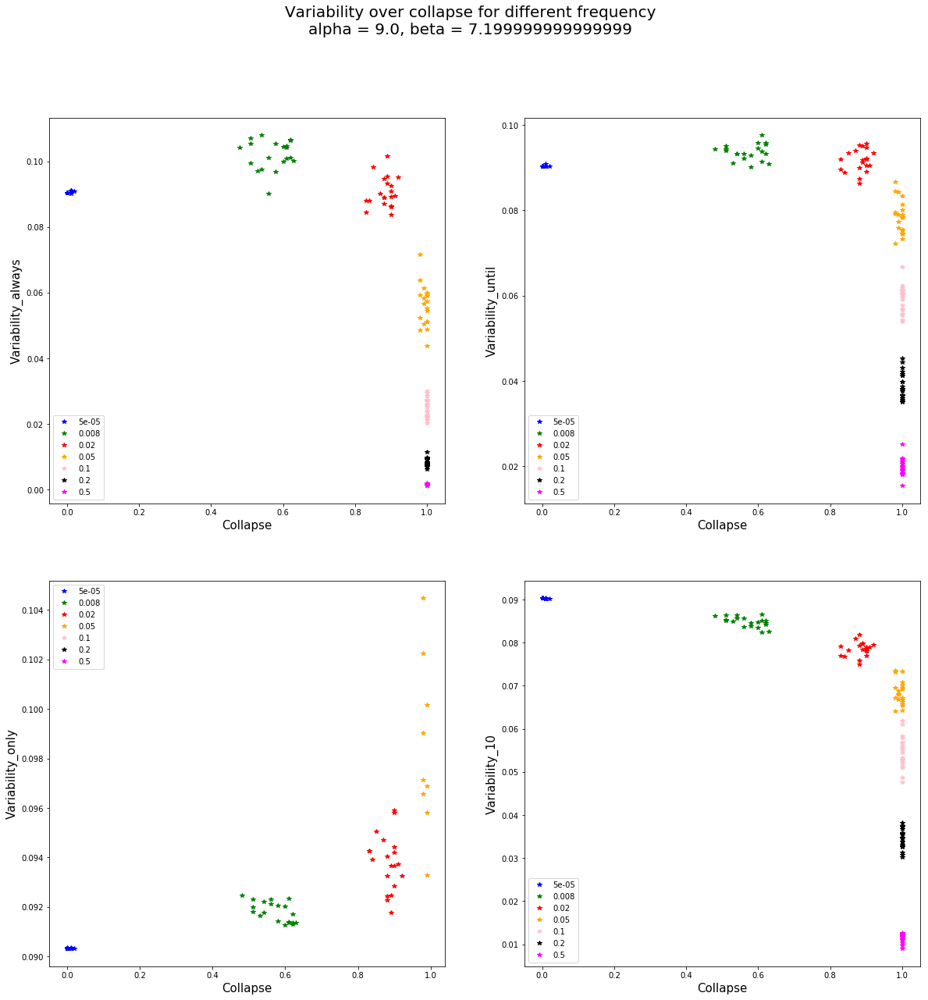

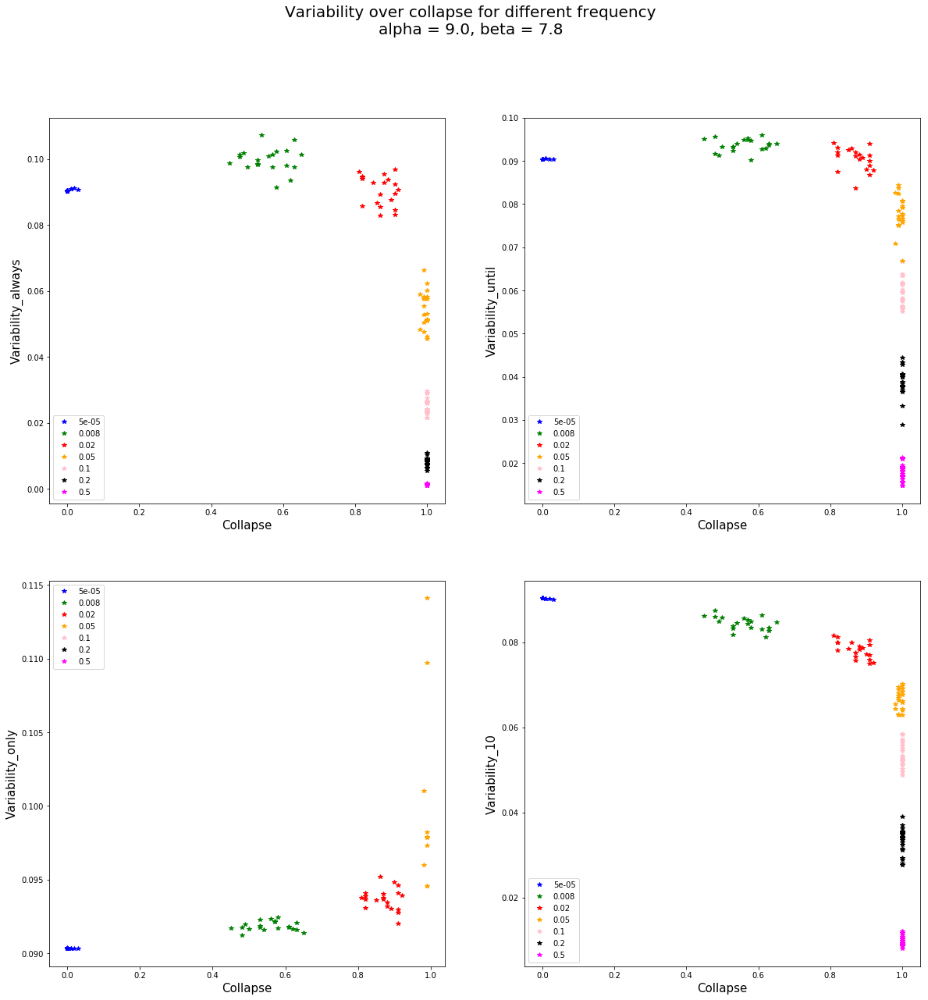

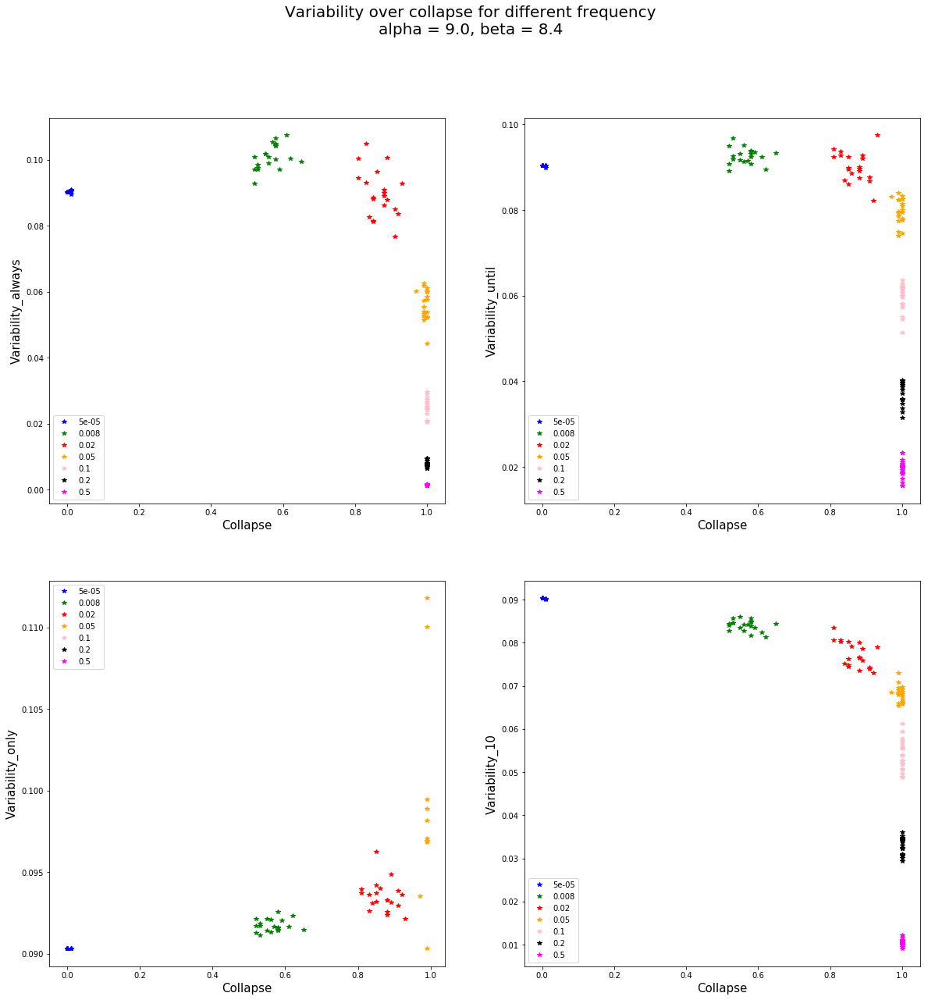

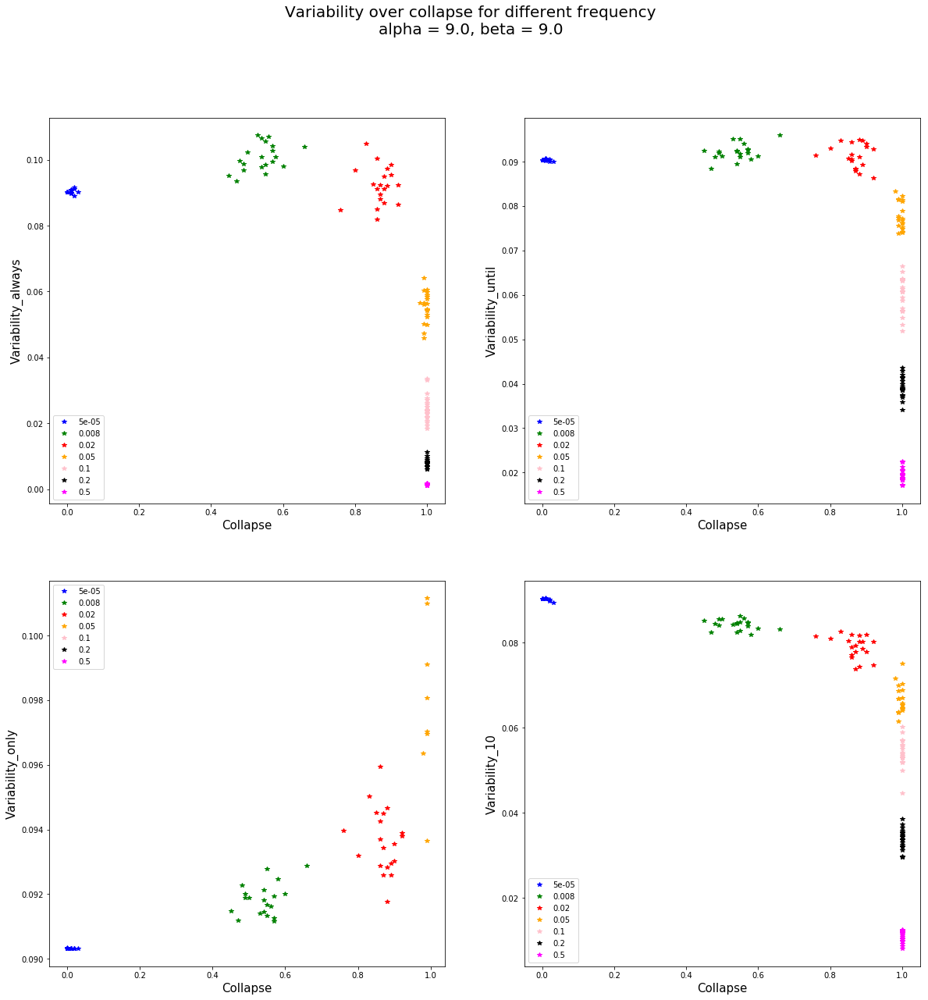

In [11]:
exec(open("object.py").read(), globals())

#Freq = [0.0005, 0.001, 0.005, 0.01, 0.05, 0.1]
Freq = [0.00005, 0.008, 0.02, 0.05, 0.1, 0.2, 0.5]

finalTime = 200
Number_of_simulation = 100
numbreDePoint = 20
Color = ["blue", "g", "red", "orange", "pink", "black", "magenta", "grey"]


Alpha = np.linspace(0, 9, 16)
Beta = np.linspace(0, 9, 16)

for alpha in Alpha:
    for beta in Beta:
        Param_coupled = {"alpha":alpha,
                         "beta":beta}
        Param_strength = {"scale":0.2}
        Fire_param = {"model": "coupled",
                        "frequence": "bernoulli",
                        "param_freq" : Param_freq,
                        "amplitude": "exponential",
                        "Param_strength" : Param_strength,
                        "Param_coupled" : Param_coupled,
                        "type" : "proportionnal",
                        "coef_W_N" : 5}


        Collapse = np.zeros((numbreDePoint, len(Freq), Number_of_simulation))
        Variability_always = np.zeros_like(Collapse)
        Variability_until = np.zeros_like(Collapse)
        Variability_only = np.zeros_like(Collapse)
        Variability_10 = np.zeros_like(Collapse)
        Collapse_10_b = np.zeros_like(Collapse)
        Collapse_10_m = np.zeros_like(Collapse)

        for j in range(numbreDePoint):
            for i, freq in enumerate(Freq):
                Param_freq = {"p":freq}
                Fire_param["param_freq"] = Param_freq
                Collapse[j,i], Variability_always[j,i], Variability_until[j,i], Variability_only[j,i], Variability_10[j,i], Collapse_10_b[j,i], Collapse_10_m[j,i] = all_measure(Number_of_simulation = Number_of_simulation, mean = False, finalTime = finalTime, Fire_param = Fire_param)


        Compute_variability = {"Variability_always": Variability_always,
                                "Variability_until": Variability_until, 
                                "Variability_only":Variability_only,
                                "Variability_10":Variability_10}


        plt.figure(figsize=(20, 20))
        plt.suptitle("Variability over collapse for different frequency\nalpha = "+str(alpha)+", beta = "+str(beta), fontsize=20)
        
        for k, compute_variability in enumerate(Compute_variability.keys()):
            #plt.figure(figsize=(12, 8))
            plt.subplot(2,2,k+1)
            for j in range(numbreDePoint):
                for i, freq in enumerate(Freq):
        #        for i, freq in enumerate(Freq):
                    if(j==0):
                        plt.plot(np.nanmean(Collapse[j,i]), np.nanmean(Compute_variability[compute_variability][j,i]), "*", color = Color[i], label=str(freq))
                    else:
                        plt.plot(np.nanmean(Collapse[j,i]), np.nanmean(Compute_variability[compute_variability][j,i]), "*", color = Color[i])

            plt.xlabel("Collapse", fontsize=15)
            plt.ylabel(compute_variability, fontsize=15)
          #  plt.ylim(ymin, ymax)
            plt.legend()

#            plt.title("Variability over collapse for different frequency\nalpha = "+str(alpha)+", beta = "+str(beta), fontsize=20)
        plt.savefig("plot/measures/coupled/alpha_beta/alpha="+str(np.round(alpha/0.01)/100)+"_beta="+str(np.round(beta/0.01)/100)+"variability_over_collapse_fire_coupled.png")
        plt.show()

## Simple

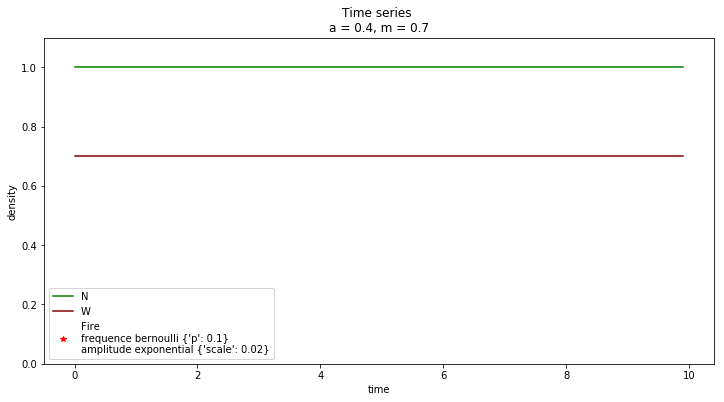

C:\Users\jerome\Anaconda3\lib\site-packages\ipykernel_launcher.py:67: RuntimeWarning: Mean of empty slice


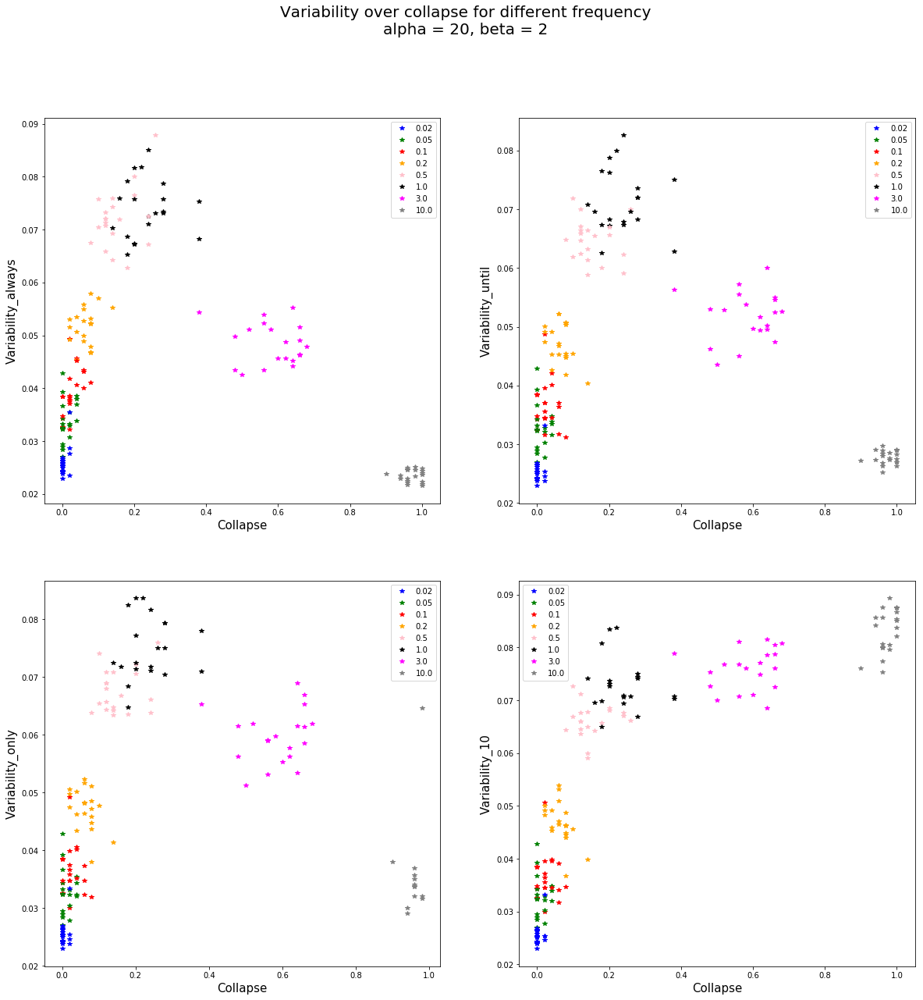

In [15]:
exec(open("object.py").read(), globals())

Freq = [0.02, 0.05, 0.1, 0.2, 0.5, 1., 3., 10.]


Param_phy= [0.4, 0.7]           
Init = [1., Param_phy[1]]


finalTime = 10
Number_of_simulation = 50
numbreDePoint = 20
Color = ["blue", "g", "red", "orange", "pink", "black", "magenta", "grey"]


alpha = 20
beta = 2
strength = 0.02
dt = 0.01

Param_coupled = {"alpha":alpha,
                 "beta":beta}
Param_strength = {"scale":strength}
Fire_param = {"model": "coupled",
                "frequence": "bernoulli",
                "param_freq" : Param_freq,
                "amplitude": "exponential",
                "Param_strength" : Param_strength,
                "Param_coupled" : Param_coupled,
                "type" : "proportionnal",
                "coef_W_N" : 5}


Collapse = np.zeros((numbreDePoint, len(Freq), Number_of_simulation))
Variability_always = np.zeros_like(Collapse)
Variability_until = np.zeros_like(Collapse)
Variability_only = np.zeros_like(Collapse)
Variability_10 = np.zeros_like(Collapse)
Collapse_10_b = np.zeros_like(Collapse)
Collapse_10_m = np.zeros_like(Collapse)

for j in range(numbreDePoint):
    for i, freq in enumerate(Freq):
        Param_freq = {"p":freq}
        Fire_param["param_freq"] = Param_freq
        Collapse[j,i], Variability_always[j,i], Variability_until[j,i], Variability_only[j,i], Variability_10[j,i], Collapse_10_b[j,i], Collapse_10_m[j,i] = all_measure(Number_of_simulation = Number_of_simulation, mean = False, finalTime = finalTime, Fire_param = Fire_param, dt = dt, Param_phy=Param_phy, Init=Init)


Compute_variability = {"Variability_always": Variability_always,
                        "Variability_until": Variability_until, 
                        "Variability_only":Variability_only,
                        "Variability_10":Variability_10}


plt.figure(figsize=(20, 20))
plt.suptitle("Variability over collapse for different frequency\nalpha = "+str(alpha)+", beta = "+str(beta), fontsize=20)

for k, compute_variability in enumerate(Compute_variability.keys()):
    #plt.figure(figsize=(12, 8))
    plt.subplot(2,2,k+1)
    for j in range(numbreDePoint):
        for i, freq in enumerate(Freq):
#        for i, freq in enumerate(Freq):
            if(j==0):
                plt.plot(np.nanmean(Collapse[j,i]), np.nanmean(Compute_variability[compute_variability][j,i]), "*", color = Color[i], label=str(freq))
            else:
                plt.plot(np.nanmean(Collapse[j,i]), np.nanmean(Compute_variability[compute_variability][j,i]), "*", color = Color[i])

    plt.xlabel("Collapse", fontsize=15)
    plt.ylabel(compute_variability, fontsize=15)
  #  plt.ylim(ymin, ymax)
    plt.legend()

#            plt.title("Variability over collapse for different frequency\nalpha = "+str(alpha)+", beta = "+str(beta), fontsize=20)
plt.savefig("plot/measures/coupled/param/variability_over_collapse.png")